# [IAPR][iapr]: Lab 1 ‒  Image segmentation


**Group ID:** 17

**Author 1 (sciper):** Timo Michoud (302039)  
**Author 2 (sciper):** Sina Röllin (315645)   
**Author 3 (sciper):** Veronika Podliesnova (390236)   

**Release date:** 05.03.2025   
**Due date:** 19.03.2025 (11:59 pm)


## Key Submission Guidelines:
- **Before submitting your notebook, <span style="color:red;">rerun</span> it from scratch!** Go to: `Kernel` > `Restart & Run All`  
- **Only groups of three will be accepted**, except in exceptional circumstances.  
- **You are not allowed to use any libraries** other than those provided in this notebook.  
- **Failure to follow these guidelines may result in point deductions** during grading.  


[iapr]: https://github.com/LTS5/iapr2025

In [1]:
# Check is at least python 3.9
import sys 
assert (sys.version_info.major == 3) and (sys.version_info.minor == 9)

In [2]:
# Install required packages
!pip install numpy -q
!pip install matplotlib -q
!pip install scikit-image -q
!pip install pillow -q

In [3]:
# Import main packages
from utils.lab_01_utils import *
from skimage.color import rgb2hsv
from skimage.morphology import closing, opening, disk, remove_small_holes, remove_small_objects, binary_dilation

---
# Introduction


In this lab, we will be working with histological data. Histological images are created from tissue samples that are digitized using high-resolution scanners. Without preparation, human tissues lack visual contrast and have poor tissue differentiations. To overcome this issue, clinical institutes use chemical staining to artificially enhance contrast. The most famous one is called HE (hematoxylin and eosin) staining. Hematoxylin stains tissue nuclei with a deep purple while eosin focuses more on extracellular matrix components with a pink stain.

Before running the following code make sure that the images are located as follows:

```code
├── labs
|   ├── utils
|   |   └── lab_01_utils.py
|   └── lab_01_iapr.ipynb
└── data
    └── data_lab_01
        ├── tcga_crc_example.png
        └── tcga_blood_example.png
```
**⚠️ DO NOT CHANGE THIS CONFIGURATION, AS WE WILL RERUN YOUR NOTEBOOK USING THIS EXACT STRUCTURE!**

By running the following cells you will display a HE histological sample of a colorectal cancer case. It is composed of 3 main entities:
* **Mucin**: Grayish mucus that is secreted by the body. The presence of a tumor tends to increase its presence. 
* **Tumor**: Dark purple aggregates (hematoxylin). Mainly composed of cancerous cells.
* **Other**: Mixture of other cells such as stromal or lymphocytes. It appears mainly pink (eosin) but is dotted with nuclei (purple).

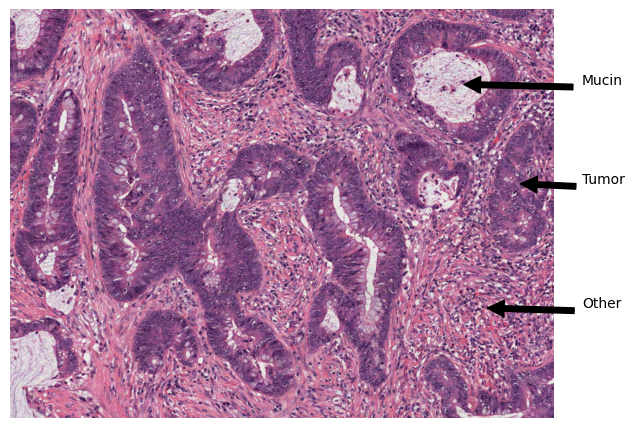

In [4]:
img_he = show_introduction_figure()


# Part 1 - Segmentation [16 pts]

## Part 1.1 - RGB (3 pts)

**Q1 (1 pts)**: In this section, you will have to complete the function `extract_rgb_channels`. The function should extract and return red, blue, and green channels from the input image `img`. Your function will be fed to `plot_colors_histo` to plot the distribution of the colors in the image. 

In [5]:
def extract_rgb_channels(img):
    """
    Extract RGB channels from the input image.

    Args
    ----
    img: np.ndarray (M, N, C)
        Input image of shape MxN and C channels.
    
    Return
    ------
    data_red: np.ndarray (M, N)
        Red channel of input image
    data_green: np.ndarray (M, N)
        Green channel of input image
    data_blue: np.ndarray (M, N)
        Blue channel of input image
    """

    # Get the shape of the input image
    M, N, _ = np.shape(img)

    # Define default values for RGB channels
    data_red = np.zeros((M, N))
    data_green = np.zeros((M, N))
    data_blue = np.zeros((M, N))

    # ------------------
    # OUR CODE:

    data_red= img[:,:,0]
    data_green = img[:,:,1]
    data_blue = img[:,:,2]
    

    # ------------------
    
    return data_red, data_green, data_blue

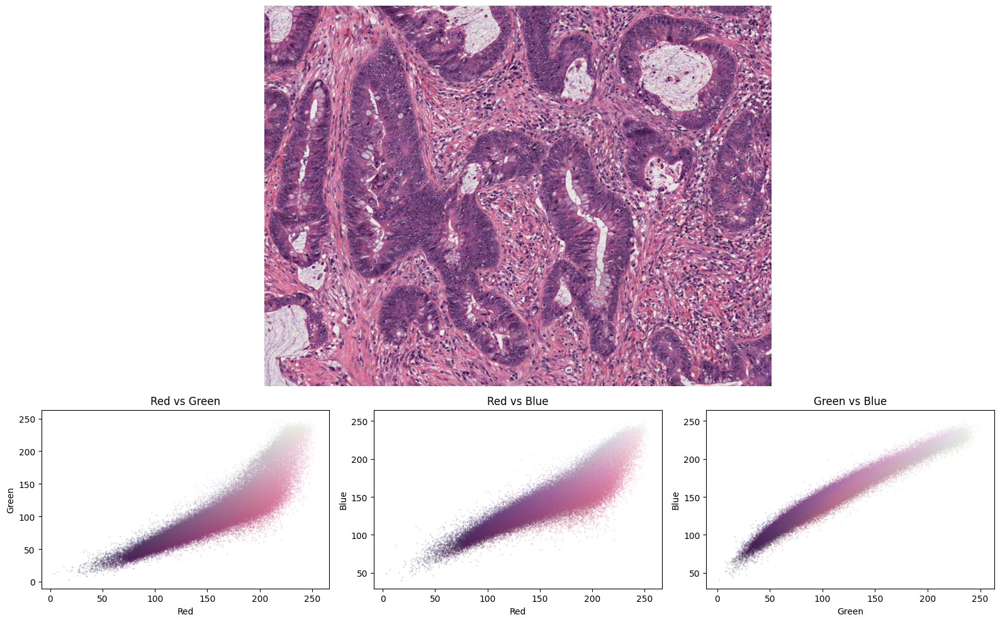

In [6]:
################################################################
############################ TEST ##############################
################################################################

plot_colors_histo(
    img = img_he,
    func = extract_rgb_channels,
    labels = ["Red", "Green", "Blue"],
)

Based on the result of the plot above

* **Q2 (1 pts)**: Do you think you can find a simple manual thresholding approach to isolate the tumor components? (Justify)
    * **Answer**: Yes, as the pixels of tumor cells are made up of a slightly darker purple colour, a manually chosen rgb-threshold set at the transition from pink to purple allows isolation of the corresponding pixels.
* **Q3 (1 pts)**: Implement your own manual thresholding in `apply_rgb_threshold` to estimate the tumor location. Use the function `plot_thresholded_image` below to display your estimation results. Do you think your estimation is reliable? (justify)
    * **Answer**: Yes, we can clearly identify the tumor cells, however, the detected area also includes additional disturbing objects namely the nuclei of healthy cells as they have a similar dark purple colour. They are therefore hard to remove using just rgb-thresholding.

In [7]:
def apply_rgb_threshold(img):
    """
    Apply threshold to input image.

    Args
    ----
    img: np.ndarray (M, N, C)
        Input image of shape MxN and C channels.
    
    Return
    ------
    img_th: np.ndarray (M, N)
        Thresholded image.
    """

    # Define the default value for the input image
    M, N, _ = np.shape(img)
    img_th = np.zeros((M, N))

    # Use the previous function to extract RGB channels
    data_red, data_green, data_blue = extract_rgb_channels(img=img)
    
    # ------------------
    # OUR CODE:

    red_mask = data_red < 125
    green_mask = data_green < 100
    blue_mask = data_blue < 150 

    img_th = red_mask & green_mask & blue_mask
    # img_th = img
    
    # img_th[:,:,0] = img
    # [data_red>100]
    # img_th[:,:,1] = [data_green>100]
    # img_th[:,:,2] = [data_blue>100]
    # img_th = [img,[data_red, data_blue, data_green]]
    
    # ------------------
    
    return  img_th

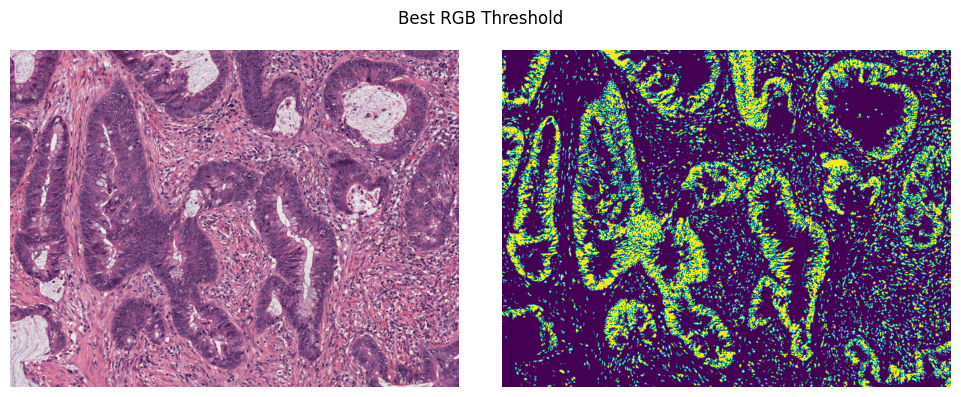

In [8]:
################################################################
############################ TEST ##############################
################################################################

# Plot best RGB thresholding
plot_thresholded_image(img=img_he, func=apply_rgb_threshold, title="Best RGB Threshold")

## Part 1.2 - Other colorspaces (3 pts)

So far we used the standard RGB colorspace to apply our thresholding. In this section, you will convert the image to a different color space. 

* **Q1 (1 pts)**: Use the function `rgb2hsv` from the skimage package ([see doc](https://scikit-image.org/docs/stable/auto_examples/color_exposure/plot_rgb_to_hsv.html)) to convert the input image from RGB to HSV in function `extract_hsv_channels`.
* **Q2 (1 pts)**: Can you see any difference between the use of the RGB or HSV space? (justify)
    * **Answer**: Yes, there is a difference in the histogram distributions because we are now concentrating on hue, saturation and value of the pixels, but it is possible to convert rgb to hsv using a mathematical formula and this implies that there is no gain or loss of information between the two colour spaces. The same information can be extracted from both.

In [9]:
def extract_hsv_channels(img):
    """
    Extract HSV channels from the input image.

    Args
    ----
    img: np.ndarray (M, N, C)
        Input image of shape MxN and C channels.
    
    Return
    ------
    data_h: np.ndarray (M, N)
        Hue channel of input image
    data_s: np.ndarray (M, N)
        Saturation channel of input image
    data_v: np.ndarray (M, N)
        Value channel of input image
    """

    # Get the shape of the input image
    M, N, C = np.shape(img)

    # Define default values for HSV channels
    hsv = np.zeros((M, N))
    # data_s = np.zeros((M, N))
    # data_v = np.zeros((M, N))

    # ------------------
    # OUR CODE:
    #rgb2hsv allows to convert the image from RGB to HSV
    hsv = rgb2hsv(img)
    data_h = hsv[:, :, 0]
    data_s = hsv[:, :, 1]
    data_v = hsv[:, :, 2]
    # ------------------
    
    return data_h, data_s, data_v

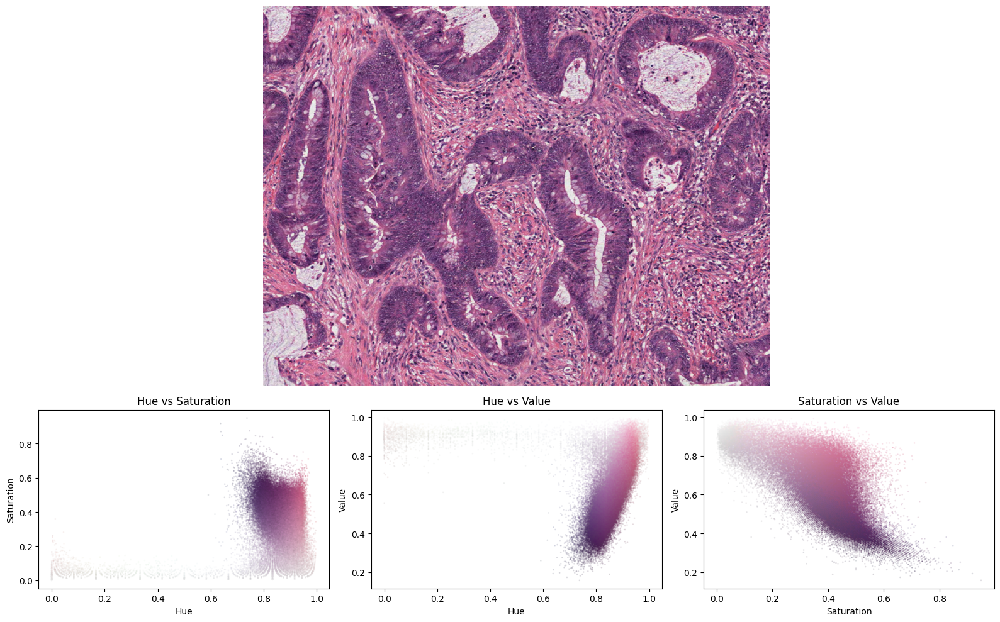

In [10]:
################################################################
############################ TEST ##############################
################################################################

# Call plotting function with your implemented function
plot_colors_histo(
    img = img_he,
    func = extract_hsv_channels,
    labels = ["Hue", "Saturation", "Value"],
)

* **Q3 (1 pts)**: Based on your results, try again to find the best manual threshold in function `apply_hsv_threshold`. Do you think your estimation is reliable? (justify)
    * **Answer**: As before we look at the histograms of distributions for saturation, hue and value of each pixel. We try to find the threshold for these three values by looking again at where there is a transition between purple and pink. This gives us values of approximately the following: Hue < 0.85, Saturation < 0.5 and Value > 0.3. <br> Ultimately the end result is almost the same as with the rgb thresholding. This is because it is possible to convert rgb to hsv using a mathematical formula. Our manually chosen thresholds are, therefore, very similar to the rgb ones calculated using the formula.

In [11]:
def apply_hsv_threshold(img):
    """
    Apply threshold to the input image in hsv colorspace.

    Args
    ----
    img: np.ndarray (M, N, C)
        Input image of shape MxN and C channels.
    
    Return
    ------
    img_th: np.ndarray (M, N)
        Thresholded image.
    """

    # Define the default value for the input image
    M, N, C = np.shape(img)
    img_th = np.zeros((M, N))

    # Use the previous function to extract HSV channels
    data_h, data_s, data_v = extract_hsv_channels(img=img)
    
    # ------------------
    # OUR CODE:
    hue_mask = data_h < 0.85
    sat_mask = data_s > 0.3
    val_mask = data_v < 0.5

    img_th = hue_mask & sat_mask & val_mask
    # ------------------
    
    return  img_th

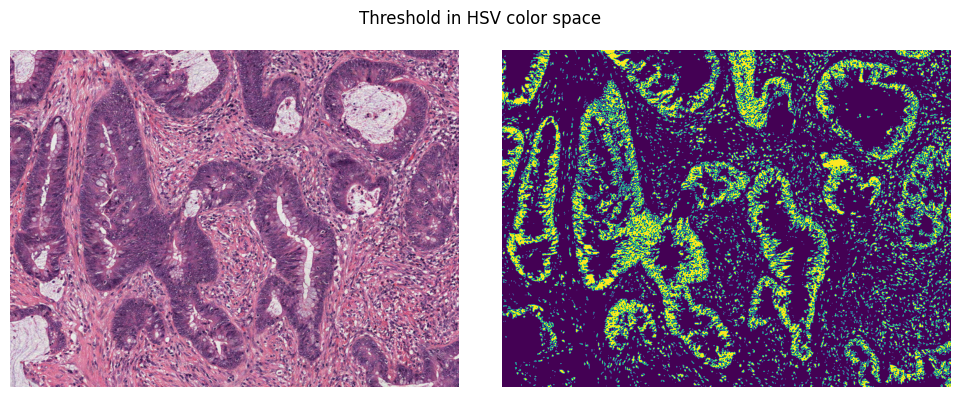

In [12]:
################################################################
############################ TEST ##############################
################################################################

# Find threshold(s) in the hsv channels
img_th=apply_hsv_threshold(img_he)
plot_thresholded_image(img=img_he, func=apply_hsv_threshold, title="Threshold in HSV color space")

## Part 1.3 - Morphology (5 pts)

To proceed, we will use your results from the previous thresholding (namely `apply_hsv_threshold`) as the starting point. In this exercise, we will try to clean the masked images using morphology to get a better estimation of the tumor area.

* **Q1 (1 pts)**: Implement the functions `apply_closing` and `apply_opening` with operations `closing` ([see doc](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.closing)), `opening` ([see doc](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.opening)) using the disk sizes arguments ([see doc](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.disk)).
* **Q2 (1 pts)**: We test disk sizes: $1, 2, 5, 10$. Comment on the quality of the results.
    * **Answer**: The quality shows a spectrum over the sizes. The closing algorithm fills the small holes in the region of interest (tumor) while the opening algorithm gets rid of the small objects detected outside of the region of interest (healthy cell nuclei). Both use the disk size as the reference for how much of an area they need to consider as one. This means that for the closing algorithm smaller disk sizes will tend to not catch all holes while too large ones will just detect everything as the region of interest (tumor). Furthermore, for the opening algorithm the smaller disk sizes will not allow to catch all the small disturbing objects (healthy cell nuclei) in the image and larger disk sizes will assume everything to be disturbing objects. These outcomes suggest that it is important to find an appropriate size for the disk used. They can differ between the two algorithms. The graphs indicate an ideal disk size of slightly higher than 2 for both the closing as well as the opening algorithm.

In [13]:
def apply_closing(img_th, disk_size):
    """
    Apply closing to input mask image using disk shape.

    Args
    ----
    img_th: np.ndarray (M, N)
        Image mask of size MxN.
    disk_size: int
        Size of the disk to use for opening

    Return
    ------
    img_closing: np.ndarray (M, N)
        Image after closing operation
    """

    # Define default value for output image
    img_closing = np.zeros_like(img_th)

    # ------------------
    # OUR CODE:
    img_closing = closing(img_th, disk(disk_size))

    # ------------------

    return img_closing


def apply_opening(img_th, disk_size):
    """
    Apply opening to input mask image using disk shape.

    Args
    ----
    img_th: np.ndarray (M, N)
        Image mask of size MxN.
    disk_size: int
        Size of the disk to use for opening

    Return
    ------
    img_opening: np.ndarray (M, N)
        Image after opening operation
    """

    # Define default value for output image
    img_opening = np.zeros_like(img_th)

    # ------------------
    # OUR CODE:
    img_opening = opening(img_th, disk(disk_size))
    # ------------------

    return img_opening


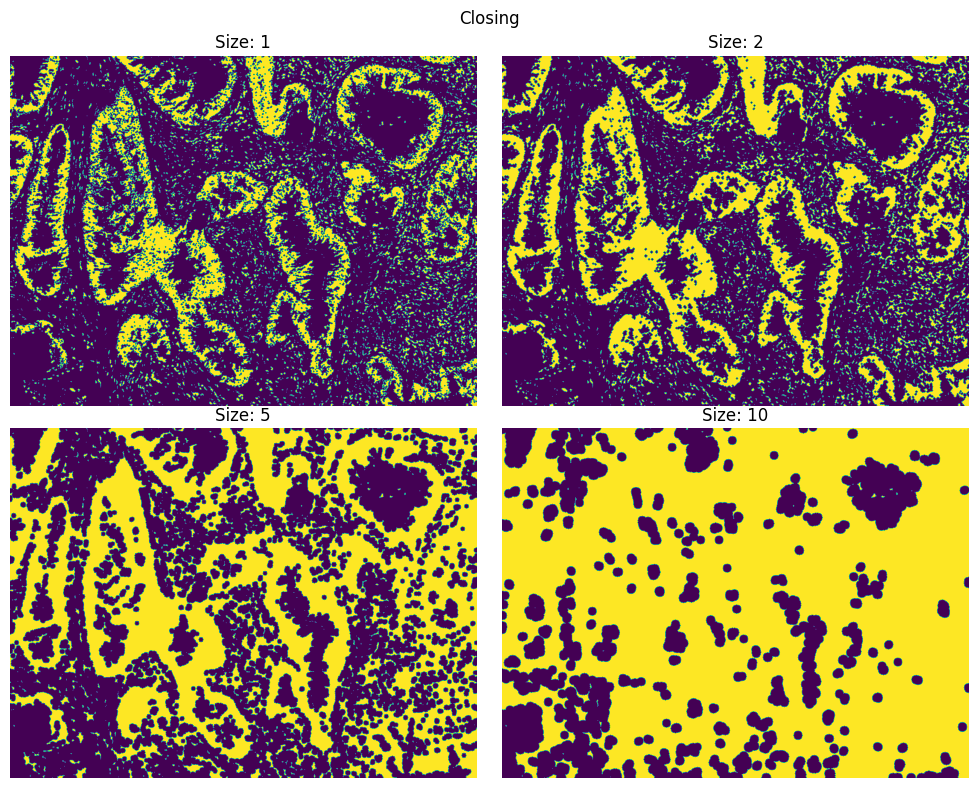

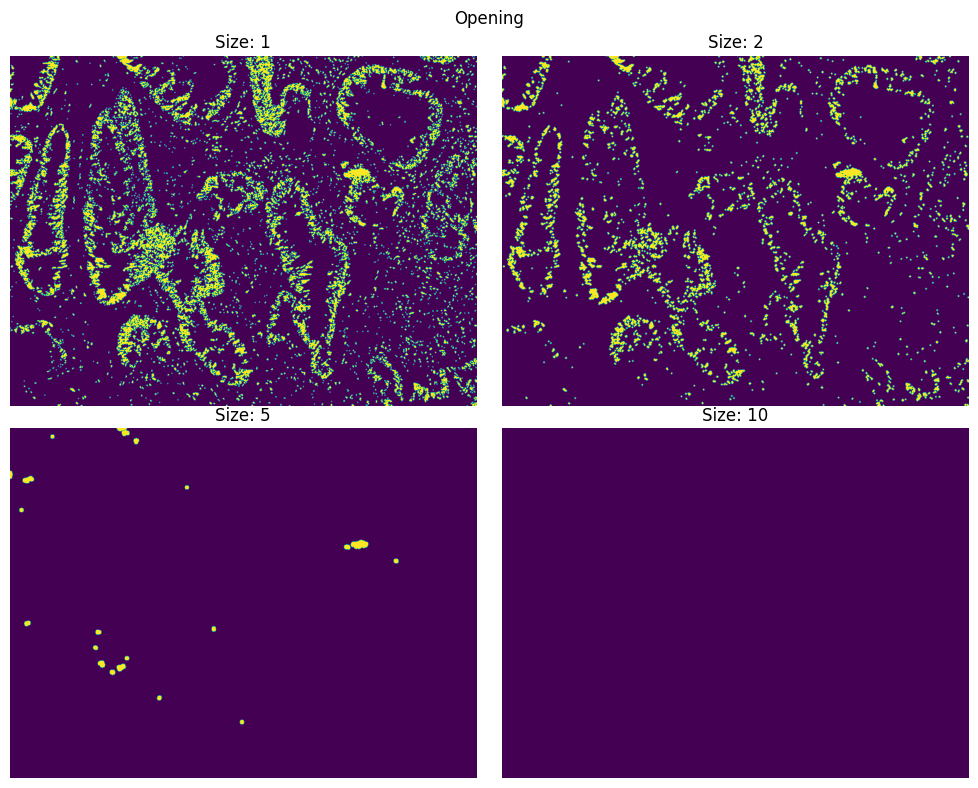

In [14]:
################################################################
############################ TEST ##############################
################################################################

plot_close_open(img_th, apply_closing, apply_opening)

* **Q3 (1 pts)** Implement the functions `remove_holes` and `remove_objects` using operations [remove_small_holes](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.remove_small_holes), [remove_small_objects](https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.remove_small_objects) from skimage package, respectively.
* **Q4 (1 pts)** We test the functions using area sizes: $10, 50, 100$, and $500$. Comment on the quality of the results.
    * **Answer**:
    As before the quality of the results depends on the sizes of the area provided to the algorithms. The bigger the chosen size the less holes (remove_holes) and the less external (to the tumor) or additional disturbing objects are detected (remove_small_objects). If the size is increased too much it again could cause non-detection of tumor areas. Especially in the case of a medical example, it is reasonable to establish a more careful approach when refining images.

In [15]:
def remove_holes(img_th, size):
    """
    Remove holes from input image that are smaller than size argument.

    Args
    ----
    img_th: np.ndarray (M, N)
        Image mask of size MxN.
    size: int
        Minimal size of holes

    Return
    ------
    img_holes: np.ndarray (M, N)
        Image after remove holes operation
    """

    # Define default value for input image
    img_holes = np.zeros_like(img_th)

    # ------------------
    # OUR CODE:
    # img_closing = apply_closing(img_th, size)
    img_holes = remove_small_holes(img_th, size)
    # ------------------

    return img_holes


def remove_objects(img_th, size):
    """
    Remove objects from input image that are smaller than size argument.

    Args
    ----
    img_th: np.ndarray (M, N)
        Image mask of size MxN.
    size: int
        Minimal size of objects

    Return
    ------
    img_obj: np.ndarray (M, N)
        Image after remove small objects operation
    """

    # Define default value for input image
    img_obj = np.zeros_like(img_th)

    # ------------------
    # OUR CODE:
    # img_opening = apply_opening(img_th, size)
    img_obj = remove_small_objects(img_th, size)
    # ------------------

    return img_obj


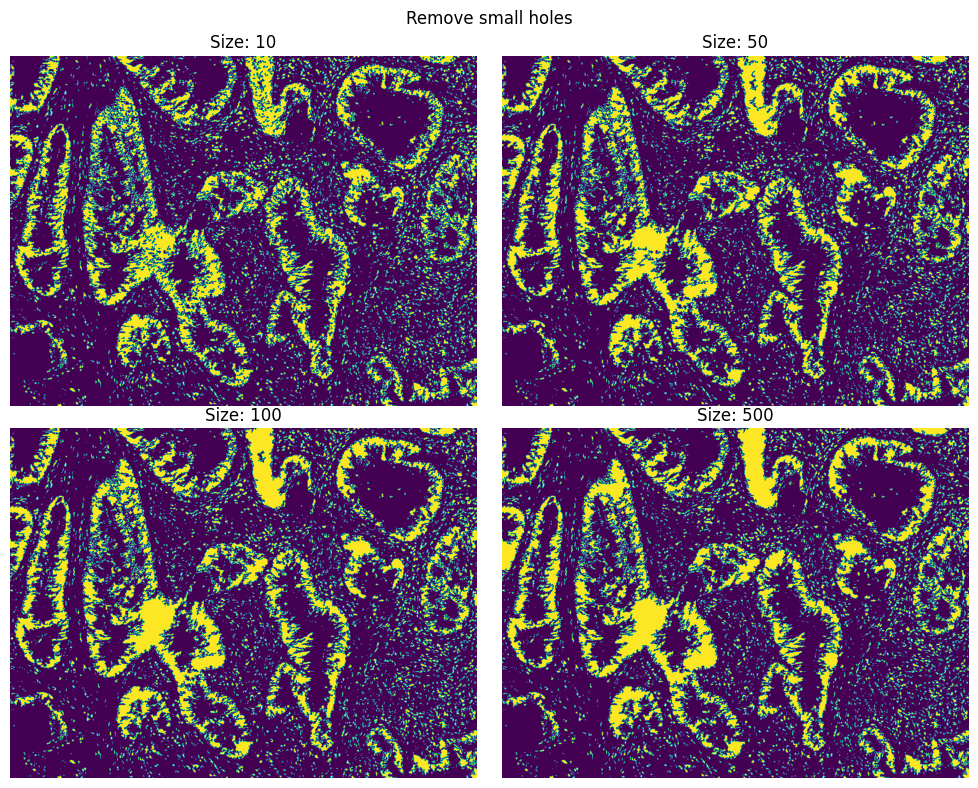

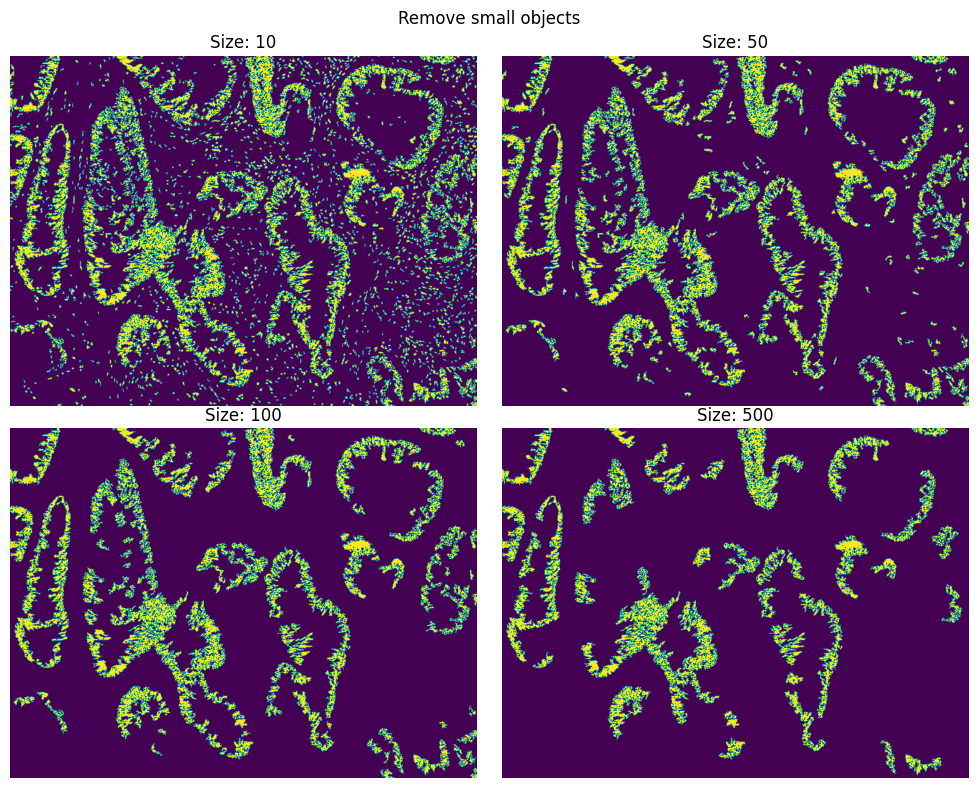

In [16]:
################################################################
############################ TEST ##############################
################################################################

plot_remove_holes_objects(img_th, remove_holes, remove_objects)

* **Q5 (1 pts)** Based on your previous results, implement the function `apply_morphology` that combines morphology functions to improve your tumor detection results from HSV thresholding. In this exercise, we prioritize having a higher number of false positives rather than false negatives, as mistakenly labeling non-tumor regions as tumors (over-segmentation) is preferable to missing actual tumor regions, which could lead to undetected cancerous areas and delayed treatment.

In [17]:
def apply_morphology(img_th):
    """
    Apply morphology to thresholded image

    Args
    ----
    img_th: np.ndarray (M, N)
        Image mask of size MxN.

    Return
    ------
    img_morph: np.ndarray (M, N)
        Image after morphological operations
    """

    img_morph = np.zeros_like(img_th)
    
    # ------------------
    # OUR CODE:
    img_1 = apply_closing(img_th, 3)
    img_2 = apply_opening(img_1, 2)
    img_3 = remove_holes(img_2, 1000)
    img_morph =remove_objects(img_3, 600)

    # ------------------
    
    return img_morph

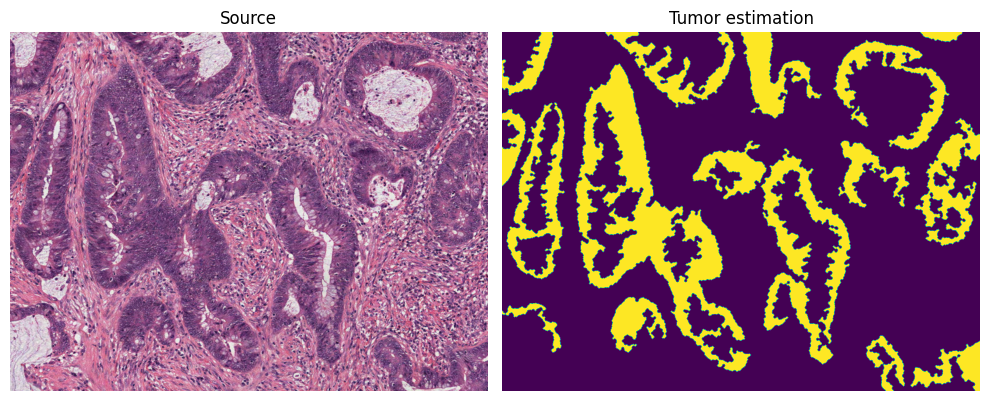

In [18]:
################################################################
############################ TEST ##############################
################################################################

img_best_morpho = apply_morphology(apply_hsv_threshold(img_he))
plot_morphology_best(
    img_source=img_he,
    img_best=img_best_morpho,
)

## Part 1.4 - Region Growing (4 pts)

* **Q1 (3 pts)** In this section we ask you to implement from scratch your own `region_growing` function to detect the tumor area. The function should take as input an RGB image, seeds that are manual initialization points in the tumor area, and the maximum number of iterations to perform. Note that the function also includes the kwargs argument. You can use it to add additional parameters to your function if needed (see [doc kwargs](https://book.pythontips.com/en/latest/args_and_kwargs.html)). Importantly, for timing reasons, a single explicit for loop on iterations is expected. An explicit for loop on pixels or neighbours will be accepted but penalised by 1 point. Use numpy tools to succeed.
* **Q2 (1 pts)** Your function is then used to perform region growing using multiple iterations. Comment on the quality of the results based on the number of iterations performed as well as the running time.
    * **Answer**: For a higher number of iterations, the algorithm is capable of mapping larger regions of interest. This means that in order to find the entire tumor region a minimal amount of iterations is necessary. The results show that the tumor regions are isolated quite accurately for around 2000 iterations. 2000 iterations require a runtime of 22.18 seconds. This relatively high runtime is due to the need to check boundary pixels and their colours at each iteration. The three other runtime's shown are not sufficient to capture enough of the tumor's region. This implies that there is a trade-off between computation time and results. At some number of iterations the algorithm is more or less just refining the region, but the number of iterations need to be high enough to capture the entire region of interest.

In [19]:
def region_growing(
    seeds: list[tuple],
    img: np.ndarray,
    n_max: int = 10,
    **kwargs
):
    """
    Run region growing on input image using seed points.

    Args
    ----
    seeds: list of tuple
        List of seed points
    img: np.ndarray (M, N, C)
        RGB image of size M, N, C
    n_max: int
        Number maximum of iterations before stopping algorithm

    Return
    ------
    rg: np.ndarray (M, N)
        Image after region growing has been performed
    """
    
    M, N, _ = img.shape
    rg = np.zeros((M, N)).astype(bool)
    
    # ------------------
    # OUR CODE:

    seeds_coord = np.asarray(seeds)
    rg[seeds_coord[:,0],seeds_coord[:,1]] = True
    ref_color = np.mean(img[rg],axis=0)
    threshold = kwargs.get('threshold')


    for _ in range(n_max):
        rg_dilated = binary_dilation(rg) & ~rg
        neighbours = np.argwhere(rg_dilated)
        color_diff = img[neighbours[:,0],neighbours[:,1]]-ref_color
        newseeds = neighbours[np.linalg.norm(color_diff,axis = 1) < threshold]
        rg[newseeds[:,0],newseeds[:,1]] = True
                    
    return rg

In [20]:
# Add your additional arguments in the dictionary below
kwargs = {
    'threshold' : 47
}

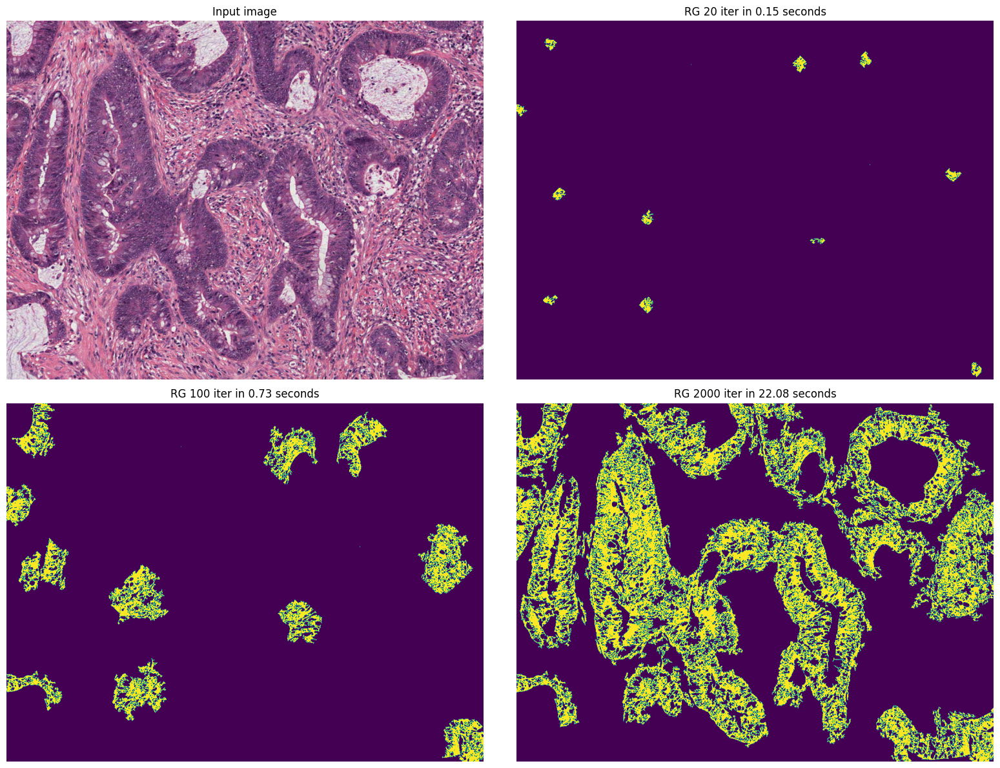

In [21]:
################################################################
############################ TEST ##############################
################################################################

img_grow = plot_tumor_region_growing(img_he, region_growing, **kwargs)

## Part 1.5 - Final Comparison (1 pts)

* **Q1 (1 pts)** Run the cell below. Based on your observation, which approach do you think gives the best estimation of the tumor area? (justify)
    * **Answer**: Depending on the make up of the tumor and depending on how much disturbing objects there are, a different algorithm could be more suitable. In this particular case the region growing approach assures the detection of very precise tumor regions whereas the HSV threshold + Morphology approach manages to return accurate outlines of the tumor with a clean background and little holes within. It is less precise but much more computationally efficient. In this medical case it could be beneficial to include more than less as we prefer to include a few healthy cells rather than leaving out cancer cells. The HSV threshold approach alone is strongly affected by the disturbing objects which lie in the same colour space and is therefore not the most suitable approach in this case.

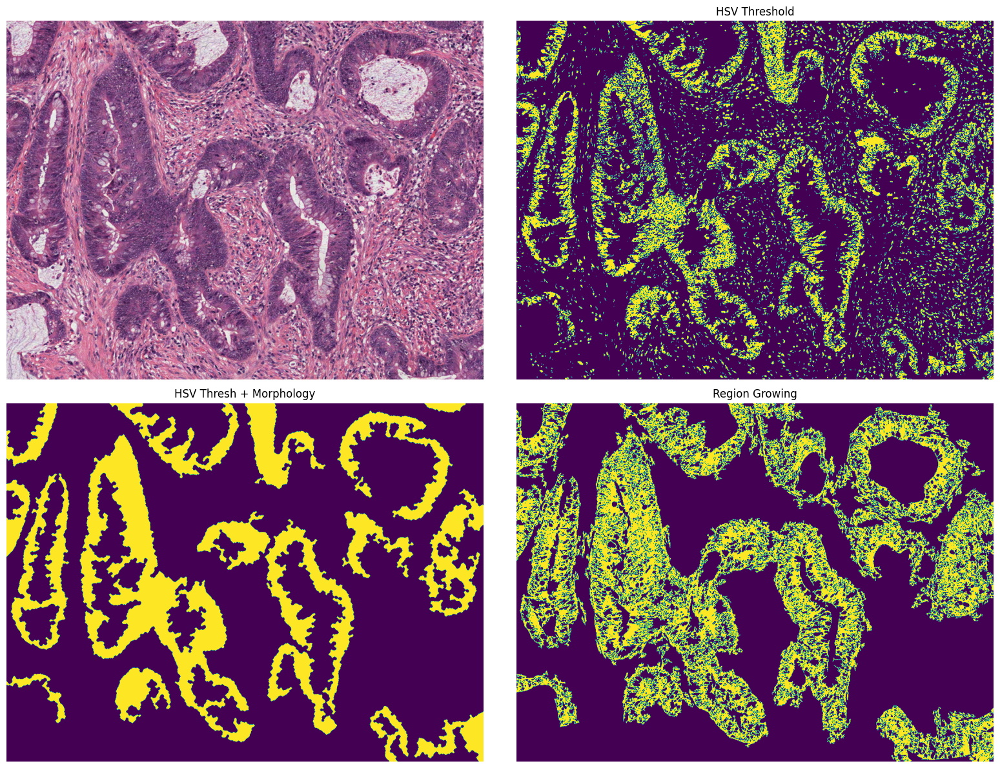

In [22]:
################################################################
############################ TEST ##############################
################################################################

plot_final_comparison(img_he, img_th, img_best_morpho, img_grow)

---
# Part 2 - Sandbox [8 pts]

For the second part, you will work on a new HE case without help. This time we ask you to
* **Q1 (4 pts)**: detect and compute the area of the blood cells,
* **Q2 (4 pts)**: detect and compute the area of the mucin.

Provide your results to the function `plot_results`. See the example below. Be careful, the completely white area is not mucin. It is the slide background and should be discarded. Moreover, you can focus on the large blood cell aggregates (large red areas)

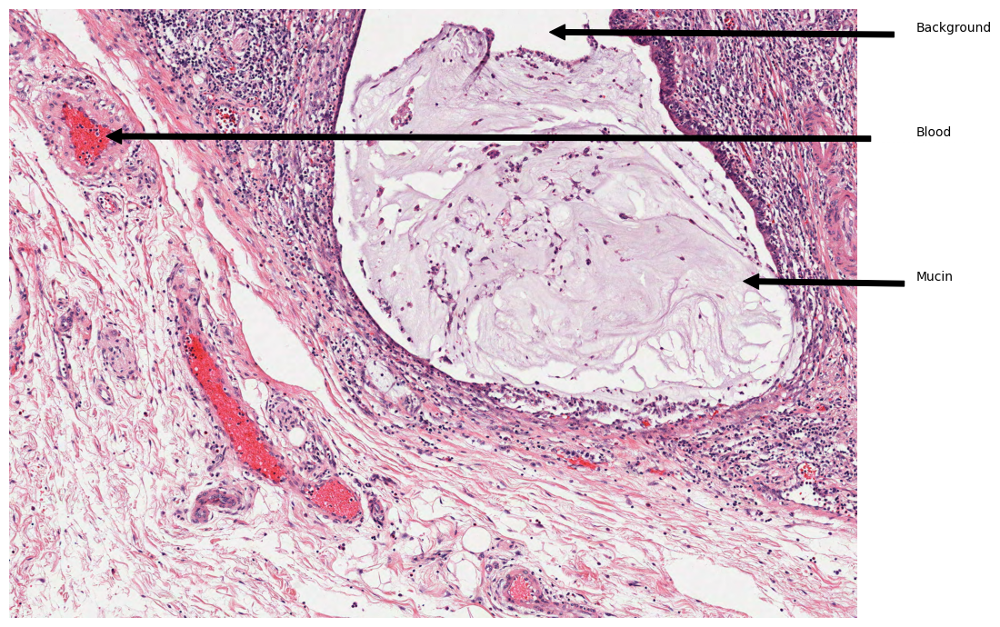

In [23]:
img_he2 = show_exo2_figure()

In [24]:
M, N, C = np.shape(img_he2)
mask_blood = np.zeros((M, N))
mask_mucin = np.zeros((M, N))

# ------------------
# OUR CODE:

#Blood mask
data_r, data_g, data_b = extract_rgb_channels(img=img_he2)
red_mask = data_r>180
blue_mask = data_g<115
green_mask = data_b<220
mask_blood = remove_small_objects((red_mask & blue_mask & green_mask),300)

#Mucin mask
data_h, data_s, data_v = extract_hsv_channels(img=img_he2)
sat_mask = data_s<0.2
val_mask = data_v>0.9 #white background to be excluded from the mask
mask_mucin = remove_small_objects(~(val_mask) & (sat_mask),400)


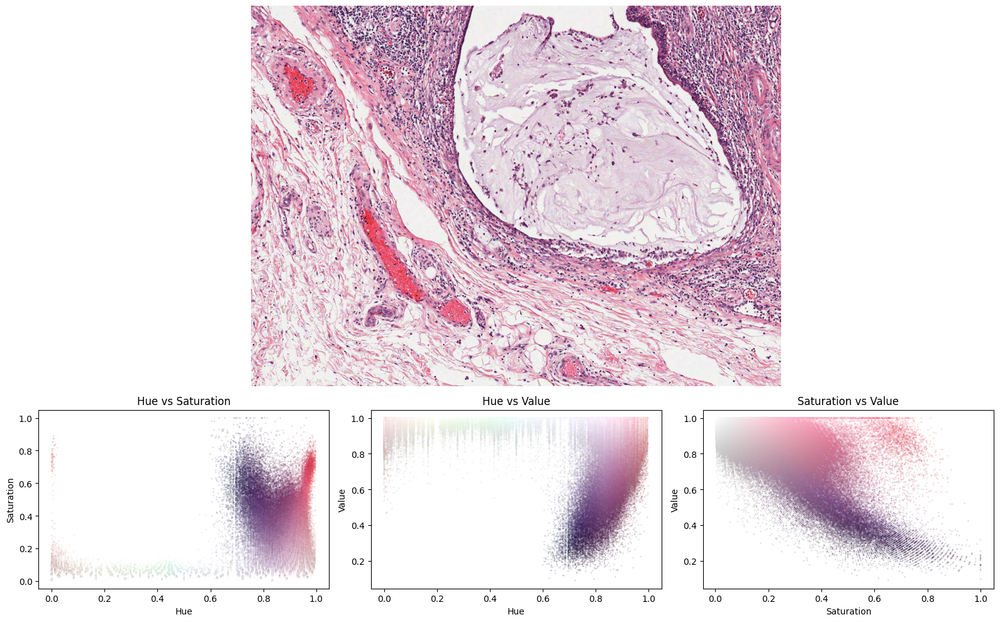

In [25]:
plot_colors_histo(
    img = img_he2,
    func = extract_hsv_channels,
    labels = ["Hue", "Saturation", "Value"],
)

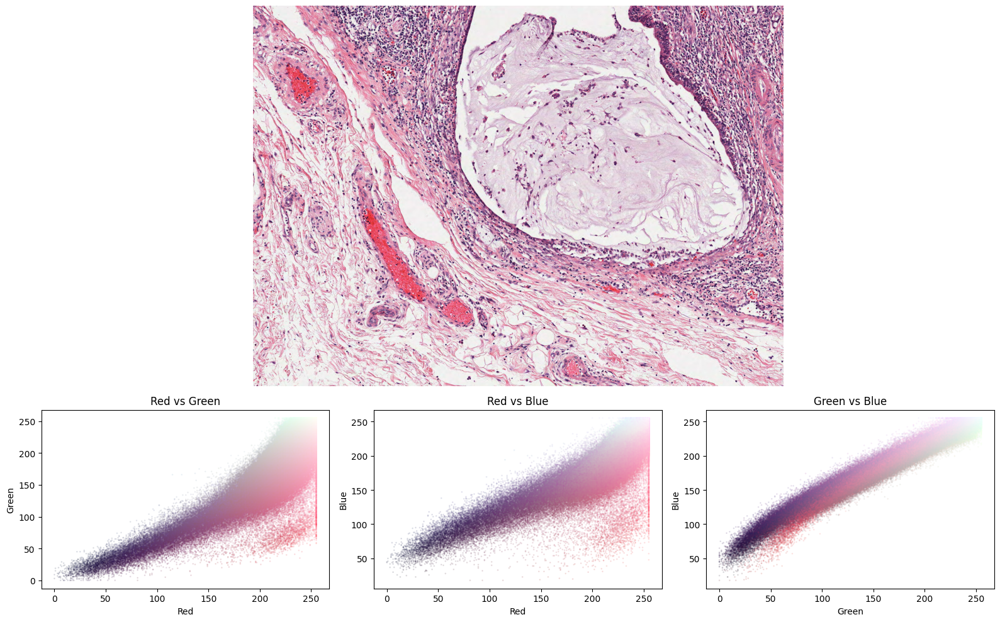

In [26]:
plot_colors_histo(
    img = img_he2,
    func = extract_rgb_channels,
    labels = ["Red", "Green", "Blue"],
)

**Results** <br>
We found the threshold values through trial and error testing of different values using the hsv and rgb histograms. The detection of the blood cells was quite straight-forward as the colour is very distinct from the rest of the image. For the mucin we had to first remove the background in order to then be able to more easily isolate the region of interest. 

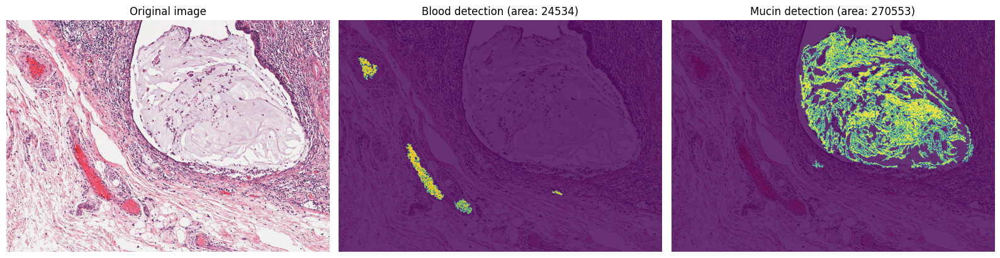

In [27]:
################################################################
############################ TEST ##############################
################################################################

plot_results(img=img_he2, mask_blood=mask_blood, mask_mucin=mask_mucin)